In [1]:
import astropy.io.fits as fits
from astropy.wcs import WCS
import pandas as pd

import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from concurrent.futures import ProcessPoolExecutor
from functools import partial
import japanize_matplotlib
from scipy.signal import fftconvolve
from scipy import signal

import random

import scipy.ndimage 
from astropy.convolution import convolve, convolve_fft, Gaussian2DKernel, Tophat2DKernel, Gaussian1DKernel
from astropy.modeling.models import Gaussian2D
import scipy.signal
from astropy.wcs import WCS

import sys
sys.path.append("/home/filament/fujimoto/Cygnus-X_CAE/data/process_tools")
from Astronomy import *
from cut_resize_tools import *

In [2]:
fits_path = "/home/filament/fujimoto/Cygnus-X_CAE/fits/Cygnus_sp16_vs-40_ve040_dv0.25_12CO_Tmb.fits"
integ_hdu = fits.open("/home/filament/fujimoto/Cygnus-X_CAE/fits/processed_fits/CygnusX_sp16_120-230_integrate_map.fits")[0]

w_high = WCS(fits_path)
hdu = fits.open(fits_path)[0]

Changed DATE-OBS from '2016-01-13        ' to '2016-01-13T00:00:00.0''. [astropy.wcs.wcs]


In [3]:
pixel_scale_arcsec = 7.5  # arcsec/pixel
beam_fwhm_arcsec = 16.0 # arcsec

# FWHMからガウス関数の標準偏差(sigma)を計算するための定数
# この定数は (2 * sqrt(2 * ln(2))) に相当します
# FWHM = constant * sigma
# sigma = FWHM / constant
constant_fwhm_to_sigma = 2 * np.sqrt(2 * np.log(2))

# 1. ビームFWHMをピクセル単位に変換
# beam_fwhm_pixel = beam_fwhm_arcsec [arcsec] / pixel_scale_arcsec [arcsec/pixel]
beam_fwhm_pixel = beam_fwhm_arcsec / pixel_scale_arcsec

# 2. ピクセル単位のFWHMをガウスの標準偏差(sigma)に変換
# obj_sig_calculated = beam_fwhm_pixel / constant_fwhm_to_sigma
obj_sig_calculated = beam_fwhm_pixel / constant_fwhm_to_sigma

# 結果の表示
print(f"ピクセルスケール (arcsec/pixel): {pixel_scale_arcsec}")
print(f"ビームFWHM (arcsec): {beam_fwhm_arcsec}")
print(f"計算されたビームFWHM (ピクセル): {beam_fwhm_pixel:.4f}")
print(f"計算された Obj_sig (ピクセル単位のガウス標準偏差): {obj_sig_calculated:.4f}")

ピクセルスケール (arcsec/pixel): 7.5
ビームFWHM (arcsec): 16.0
計算されたビームFWHM (ピクセル): 2.1333
計算された Obj_sig (ピクセル単位のガウス標準偏差): 0.9059


In [4]:
vsmooth = 5
thresh = 1
sigma = 2
sch_rms = 10
ech_rms = 90
sch_ii = 121
ech_ii = 241
percentile = 99.997
sigma_multiply = None
# width = 60

cut_size_list = [256, 128, 64]
integrate_layer_num = 30
obj_size = 100
obj_sig = obj_sig_calculated
maximum_mode = "percentile"

hdu = fits.open(fits_path)[0]
raw_d = hdu.data
head = hdu.header

In [5]:
catalogue_path = '/home/filament/fujimoto/Cygnus-X_CAE/cygnus_infer_catalogue.csv' # 提供されたCSVファイル
catalogue_data = pd.read_csv(catalogue_path)
catalogue_data

,Unnamed: 0,dec_min,ra_min,dec_max,ra_max,width_pix,height_pix
0,0,42.291897,308.650682,42.565254,308.999023,390.0,406.0
1,0,40.799006,307.460314,40.847080,307.523363,71.0,73.0
2,0,38.815480,308.056761,38.854625,308.107591,59.0,59.0
3,0,40.250445,308.097562,40.298526,308.160910,73.0,72.0
4,0,37.276328,306.827304,37.312209,306.873721,55.0,55.0
...,...,...,...,...,...,...,...
73,0,40.202114,305.540874,40.269707,305.628996,99.0,104.0
74,0,39.838105,309.394425,39.879458,309.447556,62.0,61.0
75,0,42.262325,309.294624,42.291281,309.332482,42.0,43.0
76,0,41.954736,309.778572,42.023760,309.871682,106.0,101.0


In [6]:
wcs = WCS(integ_hdu.header)

Changed DATE-OBS from '2016-01-13        ' to '2016-01-13T00:00:00.0''. [astropy.wcs.wcs]


In [7]:
babble_region_galactic = [] # 変換後の銀河座標を格納するリスト
for index, row in catalogue_data.iterrows():
    RA_min = row['ra_min'] * u.deg # 度単位でUnitsオブジェクトを作成
    RA_max = row['ra_max'] * u.deg
    DEC_min = row['dec_min'] * u.deg
    DEC_max = row['dec_max'] * u.deg

    # 各角の赤経・赤緯座標をSkyCoordオブジェクトとして定義
    # そして銀河座標系に変換
    # RA_min, DEC_min の点
    coord_min_min = SkyCoord(ra=RA_min, dec=DEC_min, frame='icrs').galactic
    # RA_max, DEC_min の点
    coord_max_min = SkyCoord(ra=RA_max, dec=DEC_min, frame='icrs').galactic
    # RA_min, DEC_max の点
    coord_min_max = SkyCoord(ra=RA_min, dec=DEC_max, frame='icrs').galactic
    # RA_max, DEC_max の点
    coord_max_max = SkyCoord(ra=RA_max, dec=DEC_max, frame='icrs').galactic

    # 変換された銀河座標 (l, b) のリストを作成
    babble_region_galactic.append([
        [coord_min_min.l.deg, coord_min_min.b.deg], # 0: L_min, B_min
        [coord_max_min.l.deg, coord_max_min.b.deg], # 1: L_max, B_min
        [coord_min_max.l.deg, coord_min_max.b.deg], # 2: L_min, B_max
        [coord_max_max.l.deg, coord_max_max.b.deg]  # 3: L_max, B_max
    ])
print(f"babble_region_galactic len: {len(babble_region_galactic)}")


# --- babble_region_pix への変換 (修正) ---
# ループ元を babble_region_galactic に変更
babble_region_pix = []
for i in range(len(babble_region_galactic)):
    babble_region = babble_region_galactic[i] # 銀河座標のバブル領域
    region_list = []
    for j in range(len(babble_region)):
        world_coords_list = [list(babble_region[j])] # [L, B] のリスト
        
        # WCS変換。世界座標 (L, B) をピクセル座標に変換
        # origin=0 でPythonの0-based indexに対応
        region_pix_result = wcs.wcs_world2pix(world_coords_list, 0)

        # 変換結果の形状と要素数をチェックする
        if len(region_pix_result) > 0 and len(region_pix_result[0]) == 2:
            region_list.append(region_pix_result[0]) # 期待通り [x, y] を追加
        else:
            print(f"警告: bubble_num={i}, point_idx={j} のWCS変換結果が不正です: {region_pix_result}. NaNで埋めます。")
            region_list.append([np.nan, np.nan]) # NaNで埋めて、後で除外されるようにする

    babble_region_pix.append(region_list)
print(f"babble_region_pix len: {len(babble_region_pix)}")

babble_region_galactic len: 78
babble_region_pix len: 78


In [8]:
cutting_ratio = 2
cutting_data_list = []
data_to_cut = raw_d.copy() # raw_d からのコピー

for bubble_num in range(len(babble_region_pix)):
    all_x_coords = [p[0] for p in babble_region_pix[bubble_num]]
    all_y_coords = [p[1] for p in babble_region_pix[bubble_num]]

    # ピクセル座標の最小値と最大値を取得
    # np.min と np.max を使うことで、座標の順序に関わらず正しい矩形領域の境界を取得
    # これにより、x_max_pix < x_min_pix のような逆転を防ぎ、スライス範囲が巨大になるのを防ぐ
    x_min_pix = int(np.floor(np.min(all_x_coords)))
    x_max_pix = int(np.ceil(np.max(all_x_coords)))
    y_min_pix = int(np.floor(np.min(all_y_coords)))
    y_max_pix = int(np.ceil(np.max(all_y_coords)))

    x_center = (x_min_pix + x_max_pix) // 2 
    y_center = (y_min_pix + y_max_pix) // 2
    
    x_range = (x_max_pix - x_min_pix) // 2 * cutting_ratio
    y_range = (y_max_pix - y_min_pix) // 2 * cutting_ratio

    x_min_pix = int(x_center - x_range)
    x_max_pix = int(x_center + x_range)
    y_min_pix = int(y_center - y_range)
    y_max_pix = int(y_center + y_range)

    # 切り出し実行
    # ここでは、np.clip を使用せず、NumPyのスライスが範囲外を0で自動パディングする動作に任せる
    # ただし、x_min_pix/y_min_pix が負になったり、x_max_pix/y_max_pix が大きくなりすぎたりすると、
    # 巨大な配列が生成される可能性がある点に注意（メモリ消費、処理時間）
    cutting_data = data_to_cut[:, y_min_pix:y_max_pix, x_min_pix:x_max_pix]
    cutting_data_list.append(cutting_data)

    # デバッグ用に切り出したデータの形状と範囲を表示してみる
    print(f"Bubble {bubble_num}: X range [{x_min_pix}, {x_max_pix}], Y range [{y_min_pix}, {y_max_pix}], Shape: {cutting_data.shape}")

Bubble 0: X range [326, 686], Y range [1124, 1480], Shape: (320, 356, 360)
Bubble 1: X range [1376, 1444], Y range [1198, 1262], Shape: (320, 64, 68)
Bubble 2: X range [2025, 2077], Y range [463, 519], Shape: (320, 56, 52)
Bubble 3: X range [1453, 1517], Y range [853, 921], Shape: (320, 68, 64)
Bubble 4: X range [2899, 2947], Y range [409, 457], Shape: (320, 48, 0)
Bubble 5: X range [1988, 2080], Y range [444, 536], Shape: (320, 92, 92)
Bubble 6: X range [1710, 1766], Y range [1987, 2043], Shape: (320, 0, 56)
Bubble 7: X range [1983, 2075], Y range [525, 617], Shape: (320, 92, 92)
Bubble 8: X range [1152, 1216], Y range [0, 64], Shape: (320, 64, 64)
Bubble 9: X range [436, 472], Y range [1087, 1123], Shape: (320, 36, 36)
Bubble 10: X range [2972, 3032], Y range [588, 648], Shape: (320, 60, 0)
Bubble 11: X range [3121, 3181], Y range [917, 977], Shape: (320, 60, 0)
Bubble 12: X range [1437, 1533], Y range [1320, 1416], Shape: (320, 96, 96)
Bubble 13: X range [430, 490], Y range [955, 10

In [9]:
deleted_indices = []
filtered_list = [
    data for idx, data in enumerate(cutting_data_list) 
    if not np.all((data == 0) | np.isnan(data))
    or deleted_indices.append(idx)  # 削除されたインデックスを記録
]

# 削除されたインデックスを表示
print("削除されたデータのインデックス:", deleted_indices)
print("削除された数: ", len(deleted_indices))
print("残ったデータ数: ",len(filtered_list))

削除されたデータのインデックス: [4, 6, 8, 10, 11, 12, 19, 22, 24, 26, 27, 31, 33, 34, 36, 37, 38, 39, 42, 44, 45, 46, 50, 51, 53, 54, 55, 57, 59, 60, 61, 63, 64, 65, 68, 71, 73]
削除された数:  37
残ったデータ数:  41


  0%|          | 0/5 [00:00<?, ?it/s]

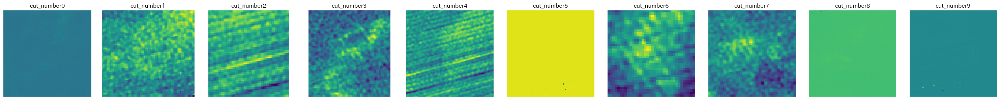

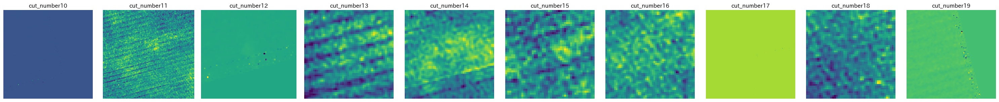

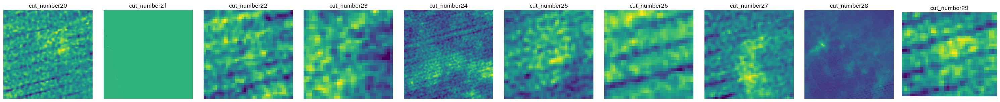

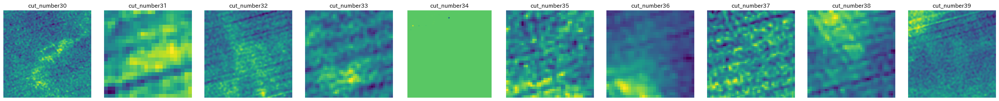

IndexError: list index out of range

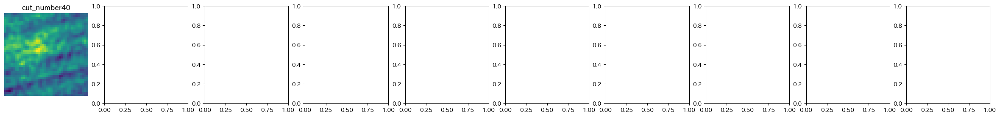

In [10]:
for m in tqdm(range(len(filtered_list) // 10 + 1)):
    m = m * 10
    fig, axes = plt.subplots(1, 10, figsize=(3*10, 3))
    for n in range(10):
        data = filtered_list[m + n]
        integ_data = np.nansum(data, axis=0)
        
        colum = (m + n) % 10
        
        axes[colum].imshow(integ_data)
        axes[colum].axis("off")
        axes[colum].set_title(f"cut_number{m + n}")

    # plt.savefig("適当領域_積分.png")
    plt.tight_layout()
    plt.show()

In [11]:
remove_list = [0, 5, 8, 9, 10, 12, 17, 19, 21, 34]
filtered_list = [data for i, data in enumerate(filtered_list) if i not in remove_list]

In [13]:
ndata_conv_list = []
for i, data in tqdm(enumerate(filtered_list)):
    data_ = process_data_segment(data, vsmooth, sch_rms, ech_rms, sch_ii, ech_ii, sigma, thresh, integrate_layer_num)
    ndata_conv_list.append(data_)

0it [00:00, ?it/s]

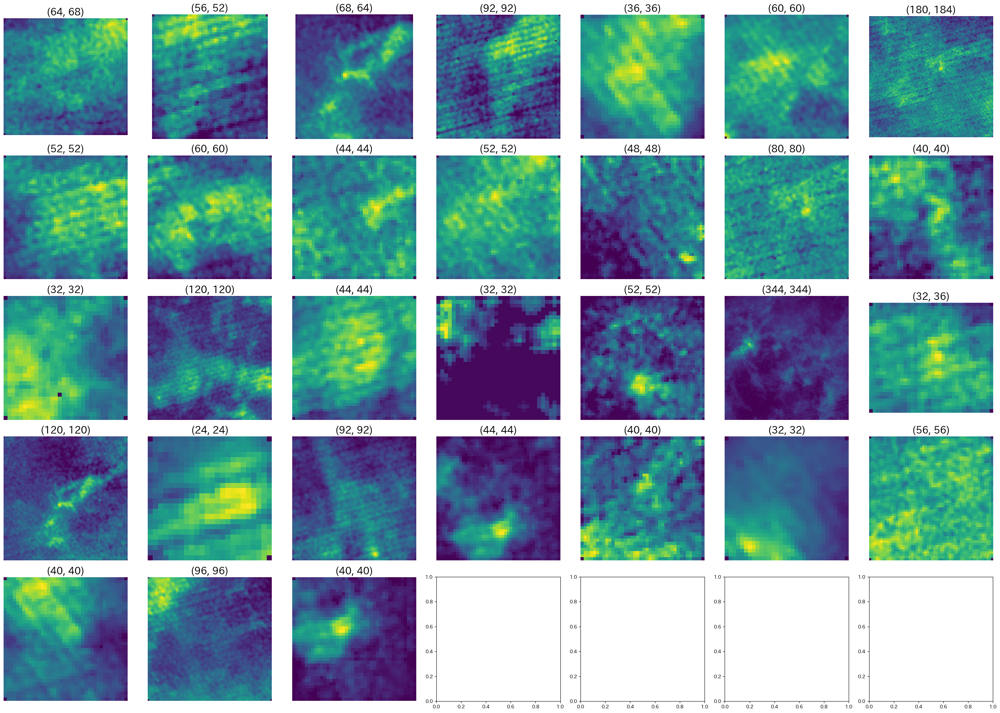

In [14]:
fig, axes = plt.subplots(5, 7, figsize=(4*7, 4*5))
axes = axes.flatten()  # 3x10の軸を1次元配列に変換

for n in range(len(ndata_conv_list)):  # 30個の画像を配置
    data = ndata_conv_list[n]
    integ_data = np.nansum(data, axis=0)
    
    axes[n].imshow(integ_data)
    axes[n].axis("off")
    axes[n].set_title((ndata_conv_list[n].shape[1], ndata_conv_list[n].shape[2]), fontsize=20)

plt.tight_layout()
# plt.savefig("bubbles_zeroing_integ_shape_3.png")
plt.show()

In [15]:
resize_list = [resize(data, (obj_size+4, obj_size+4)) for data in ndata_conv_list]
print(len(resize_list))

31


In [16]:
conv_list = [gaussian_filter(data) for data in resize_list]
print(len(conv_list))

31


In [19]:
max_thresh = maximum_value_determination(maximum_mode, raw_d, vsmooth, sch_rms, ech_rms, sch_ii, 
                                ech_ii, sigma, thresh, integrate_layer_num, percentile)

In [21]:
print(max_thresh)

132.72668899584303


In [19]:
max_thresh = 132.72668899584303

In [20]:
norm_conv_list = [np.clip(_data, a_min=None, a_max=max_thresh) for _data in conv_list]
norm_conv_list = normalization(norm_conv_list)

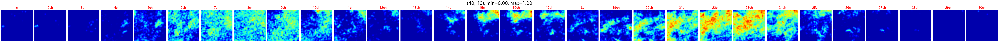

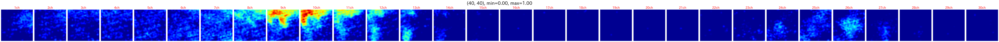

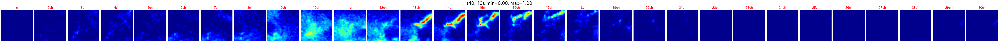

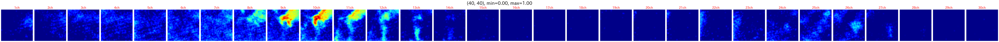

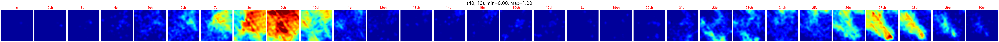

...

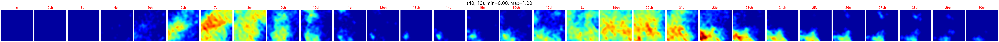

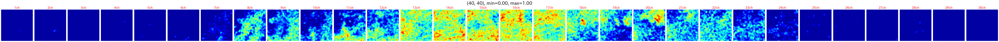

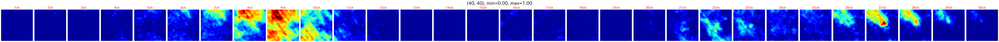

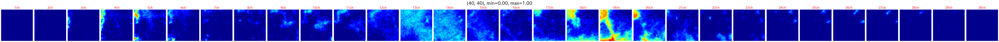

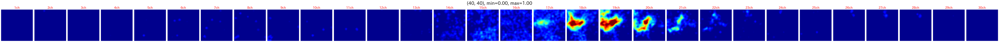

In [22]:
for i, data in enumerate(norm_conv_list):
    fig, axes = plt.subplots(1, 30, figsize=(30*3, 1*4))
    for k in range(len(data)):
        axes[k].set_title(f"{k+1}ch", fontsize=20, color='red')
        axes[k].imshow(data[k], vmin=0, vmax=1, cmap="jet")
        axes[k].axis("off")

    fig.suptitle(f"({ndata_conv_list[n].shape[1]}, {ndata_conv_list[n].shape[2]}), min={data.min():.2f}, max={data.max():.2f}", fontsize=30)
    plt.tight_layout()
    plt.savefig(f"bubble_ex_{i}_normalize.png", dpi=100)
    plt.show()

In [23]:
norm_conv_list[20].shape

(30, 100, 100)

In [24]:
for data in norm_conv_list:
    print(data.max())

1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0


In [25]:
np.save("/home/filament/fujimoto/Cygnus-X_CAE/data/zroing_resize_data/resize_data/condition_match/normalize/CygnusX_bubble_per_norm", norm_conv_list)